# Attribute inference Attack (AIA) Dataset B

In [1]:
#import libraries
import warnings
warnings.filterwarnings("ignore")
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
import os
print('Libraries imported!!')

Libraries imported!!


In [2]:
#define directory of functions and actual directory
HOME_PATH = '' #home path of the project
FUNCTIONS_DIR = 'EVALUATION FUNCTIONS/PRIVACY'
ACTUAL_DIR = os.getcwd()

#change directory to functions directory
os.chdir(HOME_PATH + FUNCTIONS_DIR)

#import functions for membership attack simulation
from attribute_inference import DataPreProcessor
from attribute_inference import RiskAttributesPredictors
from attribute_inference import identified_attributes_percentage

#change directory to actual directory
os.chdir(ACTUAL_DIR)
print('Functions imported!!')

Functions imported!!


## 1. Read real and synthetic datasets
In this part real and synthetic datasets are read.

In [3]:
#Define global variables
DATA_TYPES = ['Real','GM','SDV','CTGAN','WGANGP']
SYNTHESIZERS = ['GM','SDV','CTGAN','WGANGP']
FILEPATHS = {'Real' : HOME_PATH + 'REAL DATASETS/TRAIN DATASETS/B_Cardio_Data_Real_Train.csv',
            'GM' : HOME_PATH + 'SYNTHETIC DATASETS/GM/B_Cardio_Data_Synthetic_GM.csv',
            'SDV' : HOME_PATH + 'SYNTHETIC DATASETS/SDV/B_Cardio_Data_Synthetic_SDV.csv',
            'CTGAN' : HOME_PATH + 'SYNTHETIC DATASETS/CTGAN/B_Cardio_Data_Synthetic_CTGAN.csv',
            'WGANGP' : HOME_PATH + 'SYNTHETIC DATASETS/WGANGP/B_Cardio_Data_Synthetic_WGANGP.csv'}
categorical_columns = ['gender','cholesterol','gluc','smoke','alco','active','cardio']
data = dict()

qid_columns = ['age','gender','height','weight']
risk_attributes = ['ap_lo','ap_hi','cholesterol','gluc','smoke','alco','active','cardio']
data = dict()
data_qid = dict()
data_risk = dict()

In [4]:
#iterate over all datasets filepaths and read each dataset
for name, path in FILEPATHS.items() :
    data[name] = pd.read_csv(path)
    data[name] = data[name].drop(['id'],axis=1)
    for col in categorical_columns :
        data[name][col] = data[name][col].astype('category').cat.codes
    data_qid[name] = data[name][qid_columns]
    data_risk[name] = data[name][risk_attributes]
data

{'Real':          age  gender  height  weight  ap_hi  ap_lo  cholesterol  gluc  smoke  \
 0      21876       0     154    80.0    130     90            1     0      0   
 1      16717       1     162    70.0    140     90            0     0      0   
 2      21128       1     174    92.0    150    100            0     0      0   
 3      23366       1     173    76.0    120     82            0     0      0   
 4      20281       0     160    60.0    120     80            0     0      0   
 ...      ...     ...     ...     ...    ...    ...          ...   ...    ...   
 55995  16001       1     170    75.0    150     80            0     0      1   
 55996  23209       1     162    73.0    160     90            0     0      0   
 55997  23589       0     169    74.0    120     80            0     0      0   
 55998  18227       0     167    70.0    120     80            0     0      0   
 55999  15114       1     177    64.0    120     80            0     0      0   
 
        alco  acti

In [5]:
data_qid

{'Real':          age  gender  height  weight
 0      21876       0     154    80.0
 1      16717       1     162    70.0
 2      21128       1     174    92.0
 3      23366       1     173    76.0
 4      20281       0     160    60.0
 ...      ...     ...     ...     ...
 55995  16001       1     170    75.0
 55996  23209       1     162    73.0
 55997  23589       0     169    74.0
 55998  18227       0     167    70.0
 55999  15114       1     177    64.0
 
 [56000 rows x 4 columns],
 'GM':          age  gender  height     weight
 0      14298       1     159  68.646934
 1      22551       0     149  72.531185
 2      22729       0     148  74.919117
 3      19467       0     160  86.949278
 4      22059       0     171  83.258253
 ...      ...     ...     ...        ...
 55995  20098       0     156  60.735778
 55996  20522       1     154  88.455547
 55997  18805       0     165  79.951021
 55998  18800       1     164  66.637624
 55999  19840       1     168  68.232067
 
 [56000

In [6]:
data_risk

{'Real':        ap_lo  ap_hi  cholesterol  gluc  smoke  alco  active  cardio
 0         90    130            1     0      0     0       1       1
 1         90    140            0     0      0     0       0       1
 2        100    150            0     0      0     0       1       1
 3         82    120            0     0      0     0       1       1
 4         80    120            0     0      0     0       1       0
 ...      ...    ...          ...   ...    ...   ...     ...     ...
 55995     80    150            0     0      1     0       1       1
 55996     90    160            0     0      0     0       1       1
 55997     80    120            0     0      0     0       1       0
 55998     80    120            0     0      0     0       0       0
 55999     80    120            0     0      0     0       1       0
 
 [56000 rows x 8 columns],
 'GM':        ap_lo  ap_hi  cholesterol  gluc  smoke  alco  active  cardio
 0         97    141            0     0      0     0       1

## 2. Train models to predict attributes values

In [7]:
#initialize classifiers
categorical_columns = ['gender']
numerical_columns = None
categories = [np.array(range(2))]
    
classifiers_all = dict()
data_preprocessors = dict()
attributes_models_all = dict()

for name in SYNTHESIZERS : 
    print(name)
    data_preprocessors[name] = DataPreProcessor(categorical_columns, numerical_columns, categories)
    x_train = data_preprocessors[name].preprocess_train_data(data_qid[name])
    
    attributes_models_all[name] = RiskAttributesPredictors(data_risk[name], qid_columns)
    attributes_models_all[name].train_attributes_prediction_models(x_train)
    
    print('####################################################')

GM
Model trained for ap_lo attribute
Model trained for ap_hi attribute
Model trained for cholesterol attribute
Model trained for gluc attribute
Model trained for smoke attribute
Model trained for alco attribute
Model trained for active attribute
Model trained for cardio attribute
####################################################
SDV
Model trained for ap_lo attribute
Model trained for ap_hi attribute
Model trained for cholesterol attribute
Model trained for gluc attribute
Model trained for smoke attribute
Model trained for alco attribute
Model trained for active attribute
Model trained for cardio attribute
####################################################
CTGAN
Model trained for ap_lo attribute
Model trained for ap_hi attribute
Model trained for cholesterol attribute
Model trained for gluc attribute
Model trained for smoke attribute
Model trained for alco attribute
Model trained for active attribute
Model trained for cardio attribute
###############################################

## 3. Read Real Data and Find Combinations

In [8]:
#read real dataset
real_data = pd.read_csv(HOME_PATH + 'REAL DATASETS/TRAIN DATASETS/B_Cardio_Data_Real_Train.csv')
for col in categorical_columns :
    real_data[col] = real_data[col].astype('category').cat.codes
real_data = real_data.sample(frac=1)
real_data = real_data[0:int(len(real_data)*0.5)]
real_data

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
189,83916,21177,1,175,108.0,120,80,1,1,0,0,0,1
47667,90448,18751,0,156,81.0,120,80,3,3,0,0,1,1
23534,33504,18349,0,164,64.0,160,80,1,1,0,0,0,1
49369,44562,16027,0,152,73.0,120,80,1,1,0,0,0,1
8226,85822,22644,0,164,76.0,140,100,1,1,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
16758,37292,23399,1,169,80.0,130,70,1,1,0,0,1,1
32317,20782,17992,1,175,98.0,140,90,1,3,0,0,1,0
49663,34429,18054,0,152,59.0,110,70,1,1,0,0,1,0
1058,37336,22628,0,156,70.0,130,80,3,3,0,0,1,1


In [9]:
combinations = real_data[qid_columns]
combinations.drop_duplicates(keep='first',inplace=True) 
combinations

,age,gender,height,weight
189,21177,1,175,108.0
47667,18751,0,156,81.0
23534,18349,0,164,64.0
49369,16027,0,152,73.0
8226,22644,0,164,76.0
...,...,...,...,...
16758,23399,1,169,80.0
32317,17992,1,175,98.0
49663,18054,0,152,59.0
1058,22628,0,156,70.0


In [10]:
results_data_all = dict()
columns_results = ['age','gender','height','weight','ap_lo_rmse','ap_hi_rmse','cholesterol_accuracy','gluc_accuracy',
                   'smoke_accuracy','alco_accuracy','active_accuracy','cardio_accuracy']

for name in SYNTHESIZERS : 
    print(name)
    results_data = pd.DataFrame(columns = columns_results)
    
    for comb in combinations.values :
    
        batch = real_data.loc[(real_data['age'] == comb[0]) & (real_data['gender'] == comb[1])
                             & (real_data['height'] == comb[2]) & (real_data['weight'] == comb[3])]
        
        row_data = (batch[qid_columns].values[0]).tolist()
        print(row_data)
        x_test = data_preprocessors[name].preprocess_test_data(batch[qid_columns])
        print(x_test.shape)
        
        row = attributes_models_all[name].evaluate_attributes_prediction_models(x_test, batch, columns_results)
        
        results_data = results_data.append(row)
        
    results_data_all[name] = results_data
    print('#######################################')

GM
[21177.0, 1.0, 175.0, 108.0]
(1, 2)
Model evaluated for ap_lo attribute
Model evaluated for ap_hi attribute
Model evaluated for cholesterol attribute
Model evaluated for gluc attribute
Model evaluated for smoke attribute
Model evaluated for alco attribute
Model evaluated for active attribute
Model evaluated for cardio attribute
[18751.0, 0.0, 156.0, 81.0]
(1, 2)
Model evaluated for ap_lo attribute
Model evaluated for ap_hi attribute
Model evaluated for cholesterol attribute
Model evaluated for gluc attribute
Model evaluated for smoke attribute
Model evaluated for alco attribute
Model evaluated for active attribute
Model evaluated for cardio attribute
[18349.0, 0.0, 164.0, 64.0]
(1, 2)
Model evaluated for ap_lo attribute
Model evaluated for ap_hi attribute
Model evaluated for cholesterol attribute
Model evaluated for gluc attribute
Model evaluated for smoke attribute
Model evaluated for alco attribute
Model evaluated for active attribute
Model evaluated for cardio attribute
[16027.0,

In [ ]:
results_data_all

{'GM':         age  gender  height  weight  ap_lo_rmse  ap_hi_rmse  \
 0   21177.0     1.0   175.0   108.0         0.0         0.0   
 0   18751.0     0.0   156.0    81.0         0.0         0.0   
 0   18349.0     0.0   164.0    64.0         0.0         0.0   
 0   16027.0     0.0   152.0    73.0         0.0         0.0   
 0   22644.0     0.0   164.0    76.0         0.0         0.0   
 ..      ...     ...     ...     ...         ...         ...   
 0   23399.0     1.0   169.0    80.0         0.0         0.0   
 0   17992.0     1.0   175.0    98.0         0.0         0.0   
 0   18054.0     0.0   152.0    59.0         0.0         0.0   
 0   22628.0     0.0   156.0    70.0         0.0         0.0   
 0   17672.0     0.0   170.0    72.0         0.0         0.0   
 
     cholesterol_accuracy  gluc_accuracy  smoke_accuracy  alco_accuracy  \
 0                    1.0            1.0             1.0            1.0   
 0                    1.0            1.0             1.0            1.0   

## 5. Visuzalize obtained results

In [12]:
results_columns = ['ap_lo_rmse','ap_hi_rmse','cholesterol_accuracy','gluc_accuracy','smoke_accuracy','alco_accuracy','active_accuracy','cardio_accuracy']
len(results_columns)

8

In [13]:
for name in SYNTHESIZERS : 
    identified_attributes = identified_attributes_percentage(results_data_all[name], results_columns)
    print(name,' : ', identified_attributes)

GM  :  0.88
SDV  :  0.75
CTGAN  :  0.75
WGANGP  :  1.0


In [14]:
boxplots_data = dict()

for c in results_columns :
    boxplots_data[c] = results_data_all[SYNTHESIZERS[0]][c]
    
    for i in range(1,len(SYNTHESIZERS)) :
        boxplots_data[c] = np.column_stack((boxplots_data[c], results_data_all[SYNTHESIZERS[i]][c]))

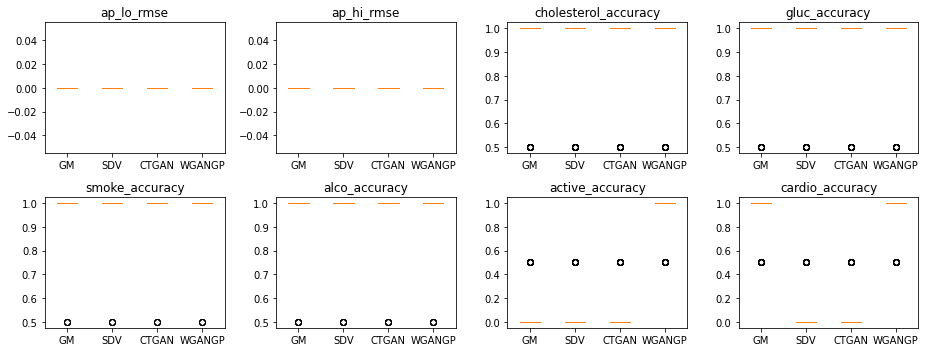

In [15]:
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(13,5))
axs_idxs = [[0,0], [0,1], [0,2], [0,3], [1,0], [1,1], [1,2], [1,3], [1,4]]
idx = dict(zip(results_columns,axs_idxs))

for c in results_columns :
    ax = axs[idx[c][0], idx[c][1]]
    ax.boxplot(boxplots_data[c])
    ax.set_title(c)
    ax.set_xticklabels(SYNTHESIZERS)
    
#fig.suptitle('Attributes Inference Tests Results \n Dataset C - Obesity level estimation', fontsize=18)
fig.tight_layout()
fig.savefig('INFERENCE TESTS RESULTS/ATTRIBUTES INFERENCE TESTS RESULTS.svg', bbox_inches='tight')